## Explore SynapseCLR representations and mark contaminations

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pylab as plt

import cuml
from cuml import PCA, TSNE, UMAP
from cuml.neighbors import NearestNeighbors, kneighbors_graph

import pickle
import igraph as ig
import leidenalg
import scipy
from scipy import sparse as sp

from synapse_utils import io
from synapse_utils import vis

SMALL_SIZE = 10
MEDIUM_SIZE = 12
BIGGER_SIZE = 14

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

In [2]:
# load SynapseCLR representations (all synapses)
repo_root = '../..'
run_id = 'synapseclr__so3__seed_42__second_stage'
checkpoint_path = f'../../output/checkpoint__{run_id}'
dataset_path = '../../data/MICrONS__L23__8_8_40__processed'

reload_epoch = 99
node_idx_list = [0, 1, 2, 3]
contamination_indices_path = None

In [3]:
# load features
load_prefix = 'encoder.fc'
save_prefix = load_prefix.replace('.', '_')
l2_normalize = False

features_nf, meta_df, meta_ext_df = io.load_features(
    checkpoint_path,
    node_idx_list,
    reload_epoch,
    feature_hook=load_prefix,
    dataset_path=dataset_path,
    l2_normalize=l2_normalize,
    contamination_indices_path=contamination_indices_path)

In [4]:
# (optionally) load previously calculated embedding
embedding_type = 'UMAP'
embedding_2d_loaded = False

try:
    features_n2 = np.load(os.path.join(checkpoint_path, 'embeddings', f'{save_prefix}__umap_2d__all_synapses.npy'))
    with open(os.path.join(checkpoint_path, 'embeddings', f'{save_prefix}__umap_2d__fit__all_synapses.pkl'), 'rb') as f:
        loader = pickle.Unpickler(f)
        umap_2d_fit = loader.load()
    embedding_2d_loaded = True
    
except:
    embedding_2d_loaded = False
    
if not embedding_2d_loaded:
    
    embedding_type = 'UMAP'
    save_results = True

    # for UMAP
    n_neighbors = 500
    n_epochs = 5000
    learning_rate = 1.0
    spread = 1.0
    min_dist = 0.1

    # for t-SNE
    perplexity = 10

    if embedding_type == 'UMAP':

        umap_2d_fit = UMAP(
            min_dist=min_dist,
            spread=spread,
            n_neighbors=n_neighbors,
            learning_rate=learning_rate,
            n_epochs=n_epochs,
            random_state=42).fit(features_nf)

        features_n2 = umap_2d_fit.embedding_

        # save embedding
        import pickle

        if save_results:

            os.makedirs(os.path.join(checkpoint_path, 'embeddings'), exist_ok=True)
            with open(os.path.join(checkpoint_path, 'embeddings', f'{save_prefix}__umap_2d__fit__all_synapses.pkl'), 'wb') as f:
                pickle.dump(umap_2d_fit, f)
            np.save(
                os.path.join(checkpoint_path, 'embeddings', f'{save_prefix}__umap_2d__all_synapses.npy'),
                features_n2)

    elif embedding_type == 'TSNE':

        tsne_2d_fit = TSNE(
            perplexity=perplexity,
            n_neighbors=n_neighbors,
            learning_rate_method=None).fit(features_nf)

        features_n2 = tsne_2d_fit.embedding_

        # save embedding
        import pickle

        if save_results:

            os.makedirs(os.path.join(checkpoint_path, 'embeddings'), exist_ok=True)
            with open(os.path.join(checkpoint_path, 'embeddings', f'{save_prefix}__tsne_2d__fit__all_synapses.pkl'), 'wb') as f:
                pickle.dump(tsne_2d_fit, f)
            np.save(
                os.path.join(checkpoint_path, 'embeddings', f'{save_prefix}__tsne_2d__all_synapses.npy'),
                features_n2)
            
# for better comparison of UMAPs w/ and w/o contaminated synapses
features_n2[:, 1] = - features_n2[:, 1]

## Clustering

In [5]:
labels_loaded = False

# load labels
try:
    labels_n = np.load(
        os.path.join(checkpoint_path, 'indices', 'leiden_labels__all_synapses.npy'))
    labels_loaded = True
    
except:
    labels_loaded = False

labels_loaded = False

if not labels_loaded:
    
    # build the k-NN connecitivity graph
    n_neighbors = 50
    a_nn = kneighbors_graph(
        features_nf,
        n_neighbors,
        mode='connectivity',
        include_self=False)


    data = a_nn.data.get()
    indices = a_nn.indices.get()
    indptr = a_nn.indptr.get()

    a_nn_scipy = sp.csr_matrix((data, indices, indptr), shape=a_nn.shape)

    # community detection
    resolution_parameter = 0.45
    similarity = 'cossim'
    temperature = 0.5

    # calculate similarity weights
    sources_e, targets_e = a_nn_scipy.nonzero()

    if similarity == 'euclidean':
        dist_mat_e = np.linalg.norm(features_nf[sources_e] - features_nf[targets_e], axis=-1)
        weights_e = 1. - dist_mat_e / np.max(dist_mat_e)

    elif similarity == 'cossim':
        cossim_e = np.einsum(
            'ef,ef->e',
            features_nf[sources_e],
            features_nf[targets_e]) / (
                np.linalg.norm(features_nf[sources_e], axis=-1) *
                np.linalg.norm(features_nf[targets_e], axis=-1))
        weights_e = np.exp(cossim_e / temperature)

    else:
        raise ValueError

    w_nn = scipy.sparse.coo_matrix((weights_e, (sources_e, targets_e)), shape=a_nn_scipy.shape)
    degree_n = np.asarray(w_nn.sum(-1)).flatten()
    normed_weights_e = weights_e / np.sqrt(degree_n[sources_e] * degree_n[targets_e])

    # build a graph object
    g = ig.Graph(directed=False)
    g.add_vertices(a_nn.shape[0])  # each observation is a node
    edges = list(zip(sources_e, targets_e))
    g.add_edges(edges)
    g.es['weight'] = normed_weights_e

    # detect communities
    partition_type = leidenalg.RBConfigurationVertexPartition
    partition_kwargs = dict(
        resolution_parameter=resolution_parameter)
    part = leidenalg.find_partition(g, partition_type, n_iterations=-1, seed=0, **partition_kwargs)
    labels_n = np.array(part.membership)

    np.save(
        os.path.join(checkpoint_path, 'indices', 'leiden_labels__all_synapses.npy'),
        labels_n)

In [6]:
# note: these UMAP positions are based on the UMAP embedding of `synapseclr__so3__seed_42__second_stage` run
highlighted_umap_pos_list = [

    # "good" clusters
    (-5, -5,),
    (2.5, -7),
    (6, -5),
    (2, 0),
    
    # "bad" clusters (e.g. reconstruction errors)
    (10, 0),
    (9, -1),
    (6, -2),
]

umap_knn_fit = NearestNeighbors(n_neighbors=5).fit(features_n2)
umap_knn_neighbors_indices = umap_knn_fit.kneighbors(np.asarray(highlighted_umap_pos_list))[1]

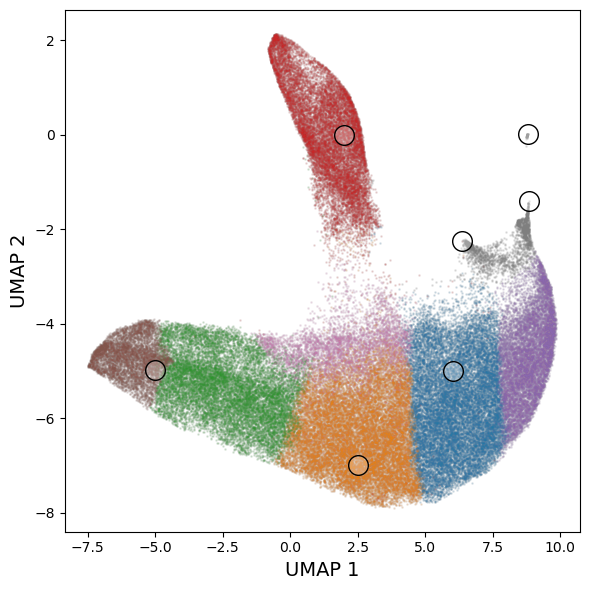

In [7]:
contamination_clusters = np.unique(labels_n)

fig, ax = plt.subplots(figsize=(6, 6))

sc = ax.scatter(
    features_n2[:, 0],
    features_n2[:, 1],
    s=1.,
    vmin=-2, vmax=2,
    alpha=0.1,
    color='gray',
    rasterized=True)


# clusters
for j in np.unique(labels_n):
    if j not in contamination_clusters:
        continue
    highlighted_indices = labels_n == j
    sc = ax.scatter(
        features_n2[highlighted_indices, 0],
        features_n2[highlighted_indices, 1],
        alpha=0.1,
        s=0.5,
        rasterized=True)

# representatives
sc = ax.scatter(
    features_n2[umap_knn_neighbors_indices[:, 0], 0],
    features_n2[umap_knn_neighbors_indices[:, 0], 1],
    lw=1.0,
    s=200,
    facecolor=(1, 1, 1, 0.25),
    edgecolor='black')

    
ax.set_xlabel(f'{embedding_type} 1', fontsize=14)
ax.set_ylabel(f'{embedding_type} 2', fontsize=14)
# ax.axis('off')
fig.tight_layout()

contamination_synapses_output_path = os.path.join(checkpoint_path, 'analysis', 'umap_contamination')
os.makedirs(contamination_synapses_output_path, exist_ok=True)

fig.savefig(
    os.path.join(
        contamination_synapses_output_path,
        'umap__clustering_with_highlights.pdf'),
    dpi=600,
    bbox_inches='tight')

## Visualize synapses from different clusters

In [8]:
ctx = vis.SynapseVisContext(
    dataset_path,
    f'../../configs/config__ext/augmenter_display.yaml',
    meta_df_override=meta_df,
    device='cuda')

cam_props = {
    'cleft_com_x': 95.,
    'cleft_com_y': 95.,
    'cleft_com_z': 95.,
    'cleft_normal': np.asarray([0., 0., 1.]),
    'cleft_inplane_1': np.asarray([1., 0., 0.]),
    'cleft_inplane_2': np.asarray([0., 1., 0.]),
}

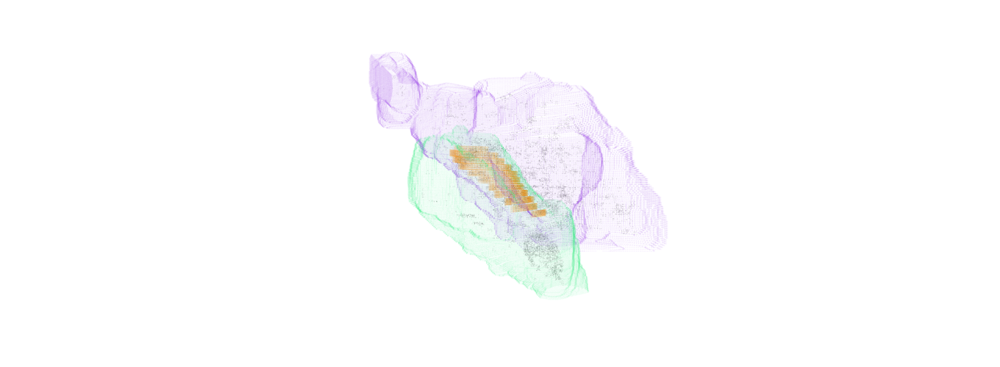

In [9]:
synapse_index = umap_knn_neighbors_indices[0, 0]

fig = vis.make_3d_synapse_figure(
    ctx,
    synapse_index,
    surface_point_cloud_opacity=0.06,
    max_points=10000,
    max_triangles=10000,
    cam_props=cam_props)

fig.show()

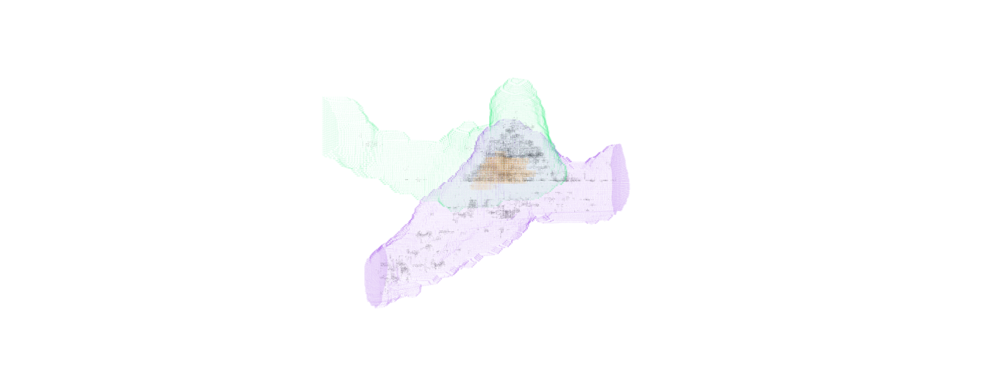

In [10]:
synapse_index = umap_knn_neighbors_indices[1, 0]

fig = vis.make_3d_synapse_figure(
    ctx,
    synapse_index,
    surface_point_cloud_opacity=0.06,
    max_points=10000,
    max_triangles=10000,
    cam_props=cam_props)

fig.show()

## Extract synapse 3D renders from different clusters

In [ ]:
highlighted_synapses_output_path = os.path.join(
    checkpoint_path, 'analysis', 'umap_contamination', 'highlighted_synapses')
os.makedirs(highlighted_synapses_output_path, exist_ok=True)

for i in range(umap_knn_neighbors_indices.shape[0]):
    for j in range(umap_knn_neighbors_indices.shape[1]):
        print(f'{i}, {j} ...')
        synapse_index = umap_knn_neighbors_indices[i, j]
        synapse_id = ctx.synapse_dataset.meta_df.iloc[synapse_index].synapse_id
        output_filename_1 = os.path.join(
            highlighted_synapses_output_path, f'umap_highlight__{i}__{j}__{synapse_id}__view_1.png')
        output_filename_2 = os.path.join(
            highlighted_synapses_output_path, f'umap_highlight__{i}__{j}__{synapse_id}__view_2.png')
        if os.path.exists(output_filename_1) and os.path.exists(output_filename_2):
            continue
        try:
            fig = vis.make_3d_synapse_figure(ctx, synapse_index, surface_point_cloud_opacity=0.06);
            fig.write_image(output_filename_1)
            fig = vis.make_3d_synapse_figure(ctx, synapse_index, fig=fig, view_plane=2, surface_point_cloud_opacity=0.06);
            fig.write_image(output_filename_2)
            
        except:  # fallback camera location to default
            fig = vis.make_3d_synapse_figure(ctx, synapse_index, surface_point_cloud_opacity=0.06, cam_props=cam_props);
            fig.write_image(output_filename_1)
            fig = vis.make_3d_synapse_figure(ctx, synapse_index, fig=fig, view_plane=2, surface_point_cloud_opacity=0.06, cam_props=cam_props);
            fig.write_image(output_filename_2)

## Visualize 2D sections from different clusters

In [15]:
ctx = vis.SynapseVisContext(
    dataset_path,
    '../../configs/config__ext/augmenter_display_no_mask_cut.yaml',
    meta_df_override=meta_df,
    device='cuda')

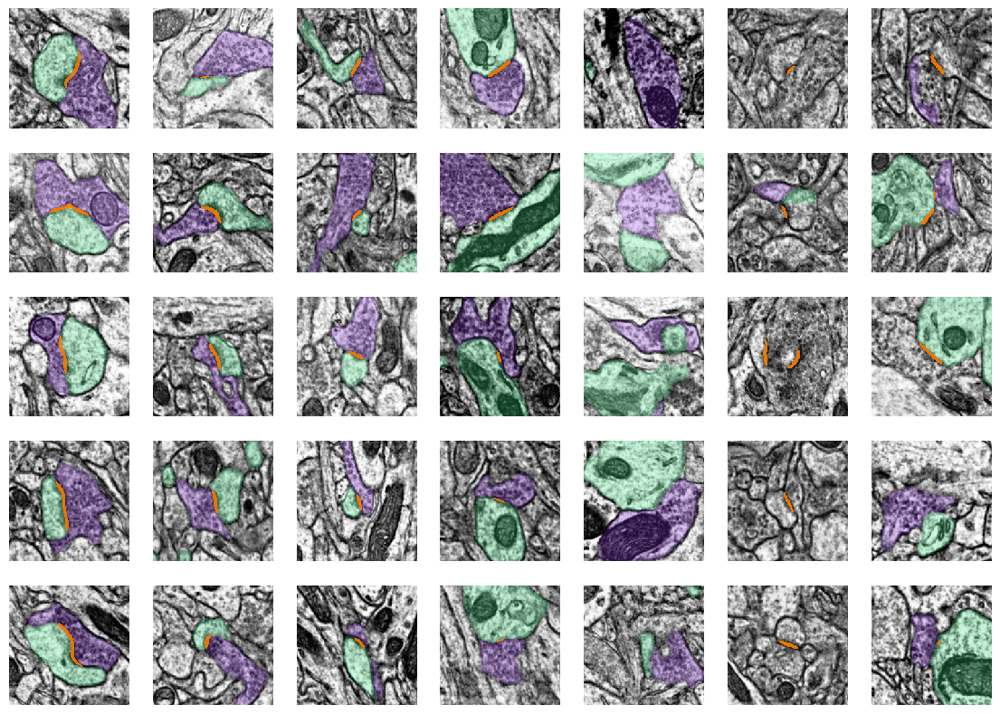

In [16]:
fig, axs = plt.subplots(
    ncols=umap_knn_neighbors_indices.shape[0],
    nrows=umap_knn_neighbors_indices.shape[1],
    figsize=(2 * umap_knn_neighbors_indices.shape[0], 2 * umap_knn_neighbors_indices.shape[1]))

for i in range(umap_knn_neighbors_indices.shape[0]):
    for j in range(umap_knn_neighbors_indices.shape[1]):
        
        synapse_index = umap_knn_neighbors_indices[i, j]

        intensity_bcxyz, mask_bcxyz = ctx.aug.augment_raw_data([ctx.synapse_dataset[synapse_index][1]])
        intensity_bcxyz = intensity_bcxyz.cpu().numpy()
        mask_bcxyz = mask_bcxyz.cpu().numpy()
        
        vis.plot_section_1_channel(
            intensity_bcxyz[0, 0, ...],
            mask_bcxyz[0, ...],
            slider_axis=2,
            section_idx=95,
            ax=axs[j, i],
            fig=fig,
            show=False);

## Extract 2D sections from different clusters

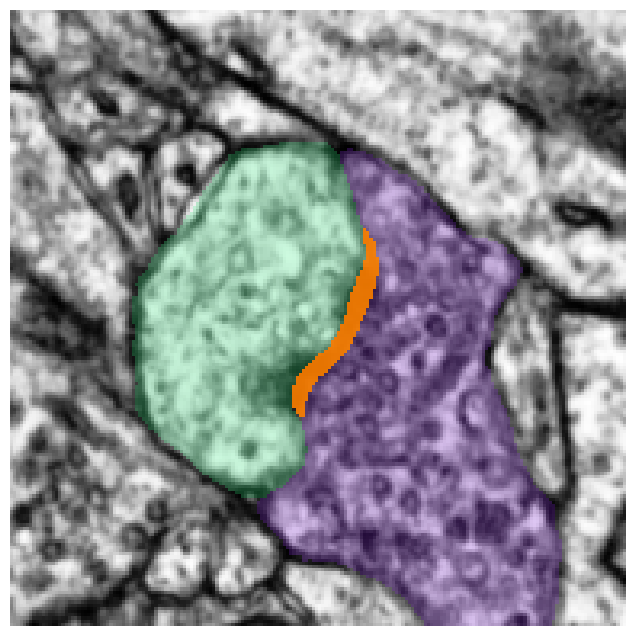

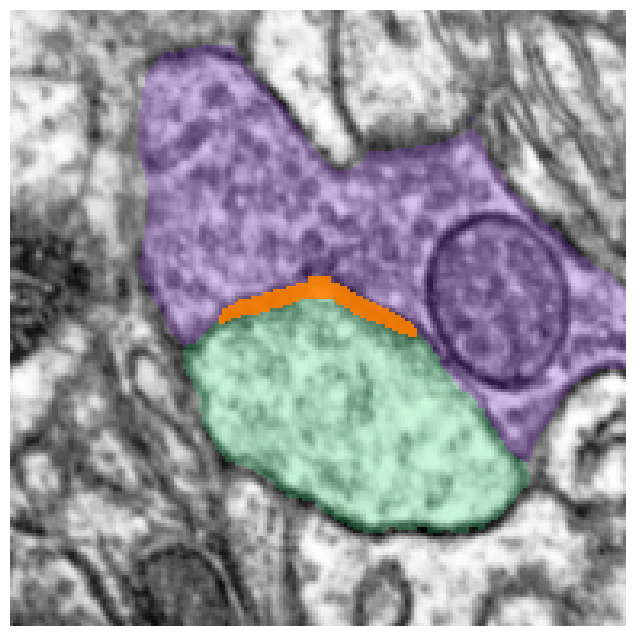

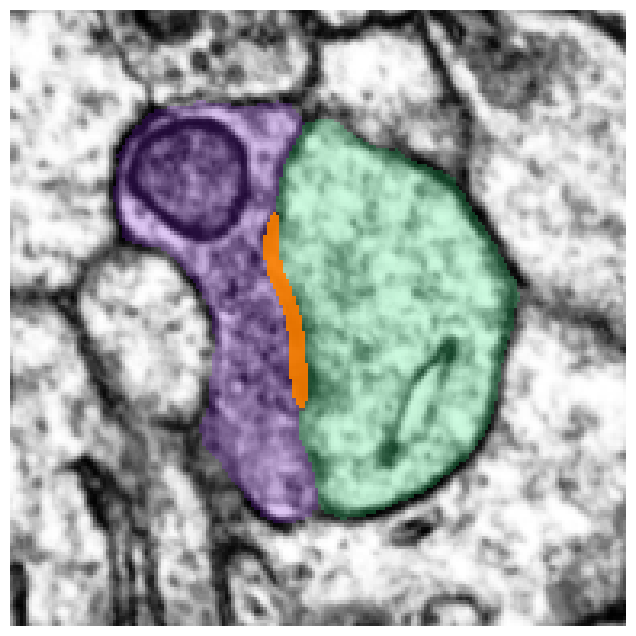

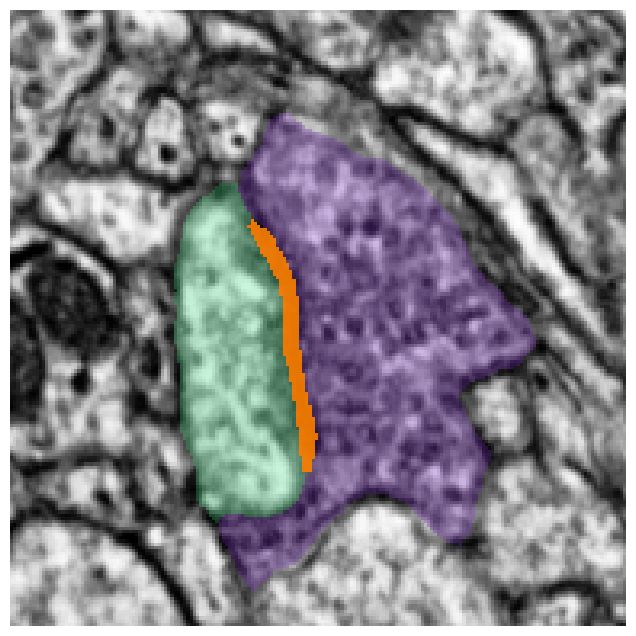

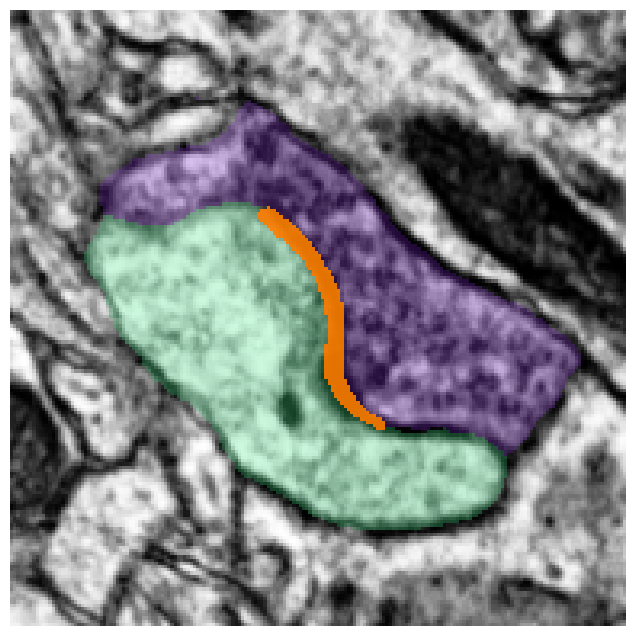

...

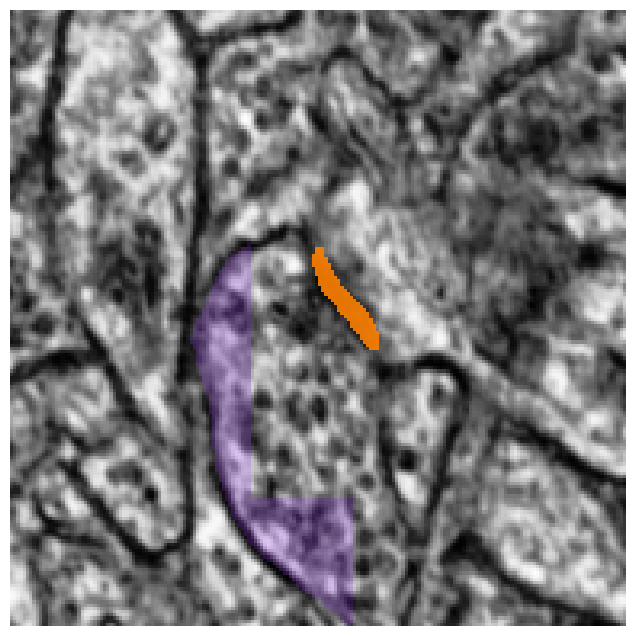

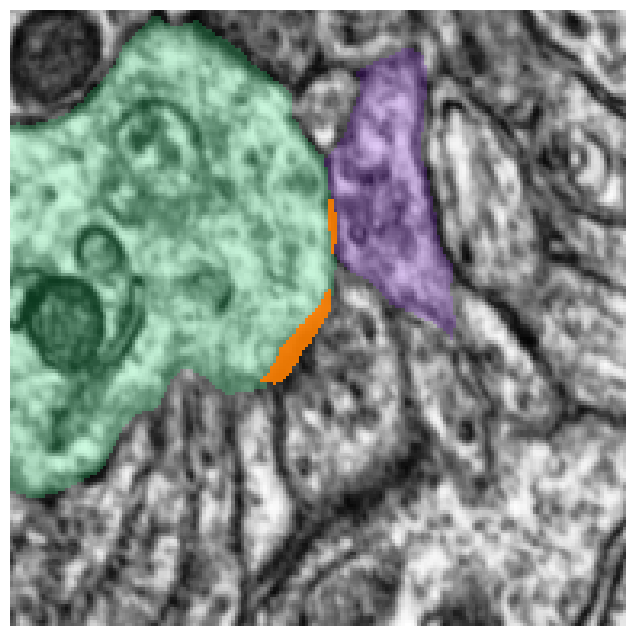

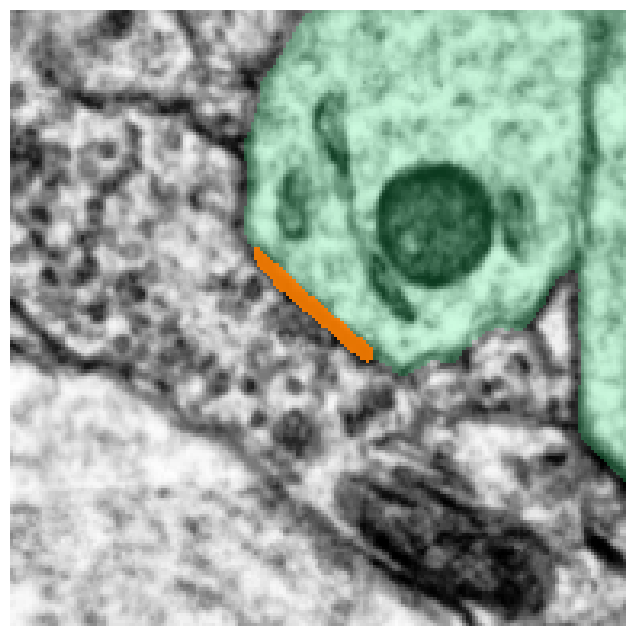

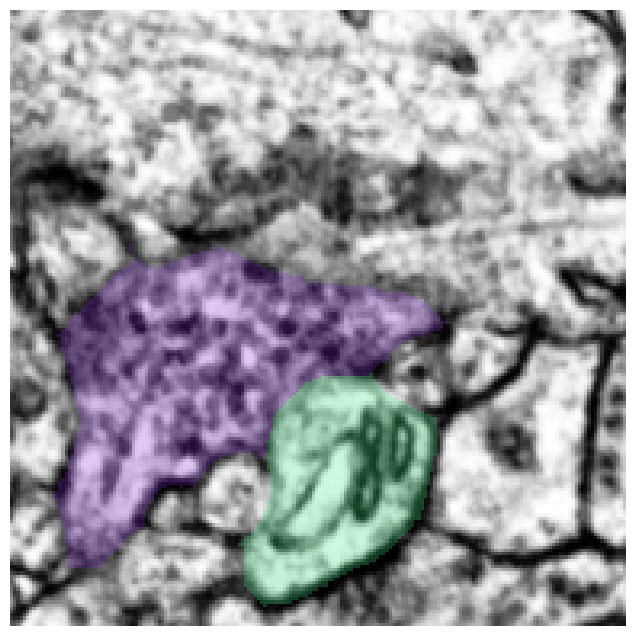

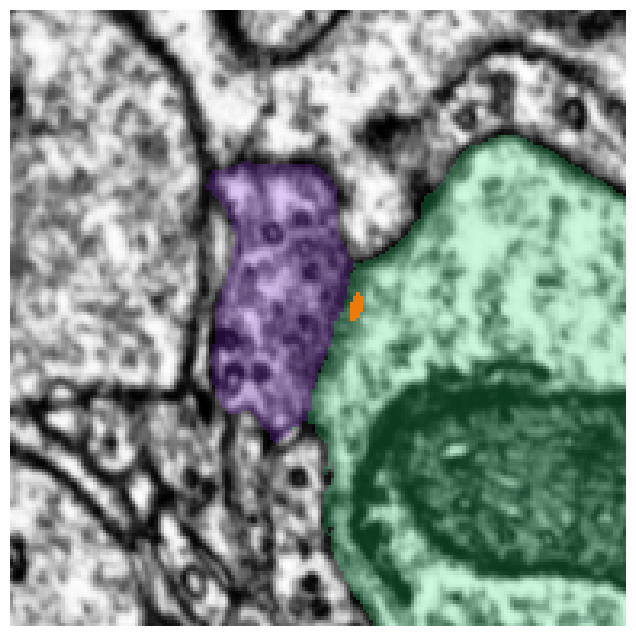

In [17]:
for i in range(umap_knn_neighbors_indices.shape[0]):
    for j in range(umap_knn_neighbors_indices.shape[1]):
        
        synapse_index = umap_knn_neighbors_indices[i, j]

        intensity_bcxyz, mask_bcxyz = ctx.aug.augment_raw_data([ctx.synapse_dataset[synapse_index][1]])
        intensity_bcxyz = intensity_bcxyz.cpu().numpy()
        mask_bcxyz = mask_bcxyz.cpu().numpy()
        
        fig, ax = vis.plot_section_1_channel(
                intensity_bcxyz[0, 0, ...],
                mask_bcxyz[0, ...],
                slider_axis=2,
                section_idx=95,
                figsize=(8, 8))
        
        fig.savefig(
            os.path.join(highlighted_synapses_output_path, f'z_section_{i}_{j}.png'),
            dpi=100)

## Interactive 2D section exploration

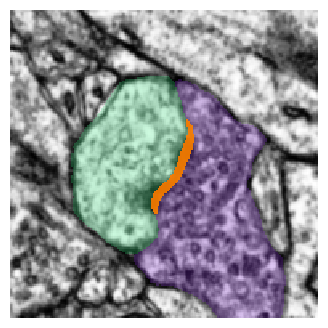

interactive(children=(IntSlider(value=95, description='section_idx', max=191), Output()), _dom_classes=('widge…

In [18]:
# a good synapse
synapse_index = umap_knn_neighbors_indices[0, 0]

vis.interact_synapse_sections(
    ctx,
    synapse_index=synapse_index)

## Identify and save the index of contaminated synapses

In [37]:
# flag contamination
contamination_seed_cluster_ind_set = {7}
contamination_pad = 1

contamination_seed_synapse_indices = []
for cluster_idx in contamination_seed_cluster_ind_set:
    contamination_seed_synapse_indices += [
        synapse_idx for synapse_idx, synapse_cluster_idx in enumerate(labels_n)
        if synapse_cluster_idx == cluster_idx]
contamination_seed_synapse_indices = np.unique(contamination_seed_synapse_indices)

print(f'{len(contamination_seed_synapse_indices)} synapses selected as contamination seeds')

2058 synapses selected as contamination seeds


In [38]:
# build a k-NN graph to select additional contaminating synapses
contamination_a_nn = kneighbors_graph(
    features_nf,
    contamination_pad,
    mode='connectivity',
    include_self=False)

In [39]:
# workaround for cuml
if str(type(contamination_a_nn)) == "<class 'cupyx.scipy.sparse.csr.csr_matrix'>":
    knn_contamination_synapse_indices = np.asarray(
        list(set(np.nonzero(contamination_a_nn[contamination_seed_synapse_indices, :].get())[1]).difference(contamination_seed_synapse_indices)))
else:
    knn_contamination_synapse_indices = np.asarray(
        list(set(np.nonzero(contamination_a_nn[contamination_seed_synapse_indices, :])[1]).difference(contamination_seed_synapse_indices)))
    
print(f'{len(knn_contamination_synapse_indices)} extra synapses selected as contamination seeds via k-NN lookup')

122 extra synapses selected as contamination seeds via k-NN lookup


In [40]:
total_contaminated_synapse_indices = np.sort(np.asarray(list(set(knn_contamination_synapse_indices).union(contamination_seed_synapse_indices))))

In [41]:
len(total_contaminated_synapse_indices)

2180

In [42]:
# WARNING: the set of contaminated indices might be slightly different in different hardware architectures
# if you wish to use the preceomputed quantities (e.g. embeddings, cluster labels, etc.) in the next set of
# notebooks, overwriting the indices of contaminated synapses is likely to invalidate precomputed values and
# their indexing.
# 
# If you wish to proceed, make sure that you clear the contents of the following
# directories and recompute from scratch:
#
#   <checkpoint_path>/
#   ├─ indices/
#   ├─ embeddings/
#

# np.save(
#     '../../tables/meta_df_contamination_indices.npy',
#     total_contaminated_synapse_indices)